<a href="https://colab.research.google.com/github/abhinavaditya811/LA-crime/blob/main/LA_Crime_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import csv
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

path="./Crime_Data_from_2020_to_Present.csv"
df=pd.read_csv(path)
print(df.dtypes)
df.head()

DR_NO               int64
Date Rptd          object
DATE OCC           object
TIME OCC            int64
AREA                int64
AREA NAME          object
Rpt Dist No         int64
Part 1-2            int64
Crm Cd              int64
Crm Cd Desc        object
Mocodes            object
Vict Age            int64
Vict Sex           object
Vict Descent       object
Premis Cd         float64
Premis Desc        object
Weapon Used Cd    float64
Weapon Desc        object
Status             object
Status Desc        object
Crm Cd 1          float64
Crm Cd 2          float64
Crm Cd 3          float64
Crm Cd 4          float64
LOCATION           object
Cross Street       object
LAT               float64
LON               float64
dtype: object


,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,AA,Adult Arrest,510.0,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,IC,Invest Cont,330.0,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628
2,200320258,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,IC,Invest Cont,480.0,NaN,NaN,NaN,1400 W 37TH ST,NaN,34.0210,-118.3002
3,200907217,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,IC,Invest Cont,343.0,NaN,NaN,NaN,14000 RIVERSIDE DR,NaN,34.1576,-118.4387
4,220614831,08/18/2022 12:00:00 AM,08/17/2020 12:00:00 AM,1200,6,Hollywood,666,2,354,THEFT OF IDENTITY,...,IC,Invest Cont,354.0,NaN,NaN,NaN,1900 TRANSIENT,NaN,34.0944,-118.3277


In [ ]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           982638 non-null  int64  
 1   Date Rptd       982638 non-null  object 
 2   DATE OCC        982638 non-null  object 
 3   TIME OCC        982638 non-null  int64  
 4   AREA            982638 non-null  int64  
 5   AREA NAME       982638 non-null  object 
 6   Rpt Dist No     982638 non-null  int64  
 7   Part 1-2        982638 non-null  int64  
 8   Crm Cd          982638 non-null  int64  
 9   Crm Cd Desc     982638 non-null  object 
 10  Mocodes         837376 non-null  object 
 11  Vict Age        982638 non-null  int64  
 12  Vict Sex        844193 non-null  object 
 13  Vict Descent    844182 non-null  object 
 14  Premis Cd       982624 non-null  float64
 15  Premis Desc     982053 non-null  object 
 16  Weapon Used Cd  326167 non-null  float64
 17  Weapon Des

In [ ]:
#handle duplicate values
duplicate = df.duplicated()
print("Duplicate rows are:\n", df[duplicate])
df = df.drop_duplicates()

Duplicate rows are:
 Empty DataFrame
Columns: [DR_NO, Date Rptd, DATE OCC, TIME OCC, AREA, AREA NAME, Rpt Dist No, Part 1-2, Crm Cd, Crm Cd Desc, Mocodes, Vict Age, Vict Sex, Vict Descent, Premis Cd, Premis Desc, Weapon Used Cd, Weapon Desc, Status, Status Desc, Crm Cd 1, Crm Cd 2, Crm Cd 3, Crm Cd 4, LOCATION, Cross Street, LAT, LON]
Index: []

[0 rows x 28 columns]


# Missing Data Imputation
## Reviewing Columns with Missing Values:
### Mocodes (object): Categorical. Neither mean nor median applies here. Mode is the most appropriate.
### Vict Sex (object): Categorical. Mean/median are irrelevant. Mode or "Unknown" is better.
### Vict Descent (object): Categorical. Mean/median irrelevant. Use "Unknown".
### Premis Cd (float64): This is categorical in nature (describes the type of premises). Mean/median don’t apply here. Mode is suitable.
### Premis Desc (object): Categorical. Mode is the right choice.
### Weapon Used Cd (float64): Categorical/ordinal. Mean or median are not appropriate because this is a classification code.
### Crm Cd 1, Crm Cd 2, Crm Cd 3, Crm Cd 4 (float64): These are crime classification codes (ordinal), not continuous variables. Neither mean nor median ### is appropriate.
###
### Cross Street (object): Categorical. Mean/median imputation doesn’t apply.

In [ ]:
## null values percentages
MissingPercentage = df.isnull().mean() * 100
print("Missing Percentage for each column is:\n", MissingPercentage)
df.head()

Missing Percentage for each column is:
 DR_NO              0.000000
Date Rptd          0.000000
DATE OCC           0.000000
TIME OCC           0.000000
AREA               0.000000
AREA NAME          0.000000
Rpt Dist No        0.000000
Part 1-2           0.000000
Crm Cd             0.000000
Crm Cd Desc        0.000000
Mocodes           14.782860
Vict Age           0.000000
Vict Sex          14.089115
Vict Descent      14.090235
Premis Cd          0.001425
Premis Desc        0.059534
Weapon Used Cd    66.807003
Weapon Desc       66.807003
Status             0.000102
Status Desc        0.000000
Crm Cd 1           0.001119
Crm Cd 2          92.990806
Crm Cd 3          99.764817
Crm Cd 4          99.993487
LOCATION           0.000000
Cross Street      84.546802
LAT                0.000000
LON                0.000000
dtype: float64


,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,AA,Adult Arrest,510.0,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,IC,Invest Cont,330.0,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628
2,200320258,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,IC,Invest Cont,480.0,NaN,NaN,NaN,1400 W 37TH ST,NaN,34.0210,-118.3002
3,200907217,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,IC,Invest Cont,343.0,NaN,NaN,NaN,14000 RIVERSIDE DR,NaN,34.1576,-118.4387
4,220614831,08/18/2022 12:00:00 AM,08/17/2020 12:00:00 AM,1200,6,Hollywood,666,2,354,THEFT OF IDENTITY,...,IC,Invest Cont,354.0,NaN,NaN,NaN,1900 TRANSIENT,NaN,34.0944,-118.3277


In [ ]:
# Mode Imputation
mode_cols = ['Mocodes', 'Premis Cd', 'Premis Desc', 'Status', 'Crm Cd 1']
for col in mode_cols:
    # Use the fillna with assignment to avoid inplace modifications
    df[col] = df[col].fillna(df[col].mode()[0])

# Imputation with "Unknown" category for categorical columns
unknown_cols = ['Vict Sex', 'Vict Descent']
for col in unknown_cols:
    # Use fillna with assignment instead of inplace=True
    df[col] = df[col].fillna('Unknown')

# Drop columns with high percentage of missing values
drop_cols = ['Weapon Used Cd', 'Weapon Desc', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'Cross Street']
df.drop(columns=drop_cols, inplace=True)

# After imputation, checking if there are any remaining missing values
missing_data_after_imputation = df.isnull().sum()
print(missing_data_after_imputation[missing_data_after_imputation > 0])  # Should return no columns


Series([], dtype: int64)


## Conversion of column data types as necessary.

In [ ]:
#convert to date format
df['Date Rptd'] = pd.to_datetime(df['Date Rptd'], format = "%m/%d/%Y %I:%M:%S %p", errors='coerce')
df['DATE OCC'] = pd.to_datetime(df['DATE OCC'], format = "%m/%d/%Y %I:%M:%S %p", errors='coerce')

print(df.dtypes)

DR_NO                    int64
Date Rptd       datetime64[ns]
DATE OCC        datetime64[ns]
TIME OCC                 int64
AREA                     int64
AREA NAME               object
Rpt Dist No              int64
Part 1-2                 int64
Crm Cd                   int64
Crm Cd Desc             object
Mocodes                 object
Vict Age                 int64
Vict Sex                object
Vict Descent            object
Premis Cd              float64
Premis Desc             object
Status                  object
Status Desc             object
Crm Cd 1               float64
LOCATION                object
LAT                    float64
LON                    float64
dtype: object


In [ ]:
df['day_occ'] = df['DATE OCC'].dt.day
df['month_occ'] = df['DATE OCC'].dt.month
df['year_occ'] = df['DATE OCC'].dt.year
df['day'] = df['DATE OCC'].dt.dayofweek
# 0 is monday and so on
df['day_name'] = df['DATE OCC'].dt.day_name()
df.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status Desc,Crm Cd 1,LOCATION,LAT,LON,day_occ,month_occ,year_occ,day,day_name
0,190326475,2020-03-01,2020-03-01,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,Adult Arrest,510.0,1900 S LONGWOOD AV,34.0375,-118.3506,1,3,2020,6,Sunday
1,200106753,2020-02-09,2020-02-08,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,Invest Cont,330.0,1000 S FLOWER ST,34.0444,-118.2628,8,2,2020,5,Saturday
2,200320258,2020-11-11,2020-11-04,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,Invest Cont,480.0,1400 W 37TH ST,34.0210,-118.3002,4,11,2020,2,Wednesday
3,200907217,2023-05-10,2020-03-10,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,Invest Cont,343.0,14000 RIVERSIDE DR,34.1576,-118.4387,10,3,2020,1,Tuesday
4,220614831,2022-08-18,2020-08-17,1200,6,Hollywood,666,2,354,THEFT OF IDENTITY,...,Invest Cont,354.0,1900 TRANSIENT,34.0944,-118.3277,17,8,2020,0,Monday


year_occ
2020    199787
2021    209805
2022    235152
2023    232130
2024    105764
Name: count, dtype: int64


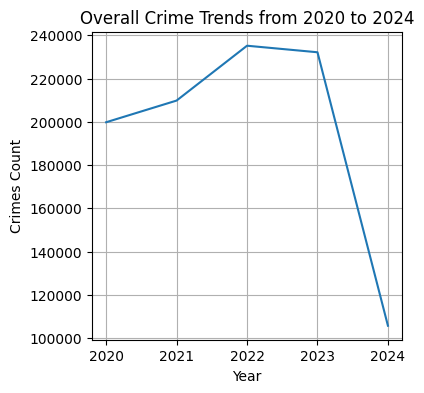

In [ ]:
#Count crimes per year
year_counts = df['year_occ'].value_counts().sort_index()
print(year_counts)
plt.figure(figsize=(4, 4))
plt.plot(year_counts.index, year_counts.values)
plt.title('Overall Crime Trends from 2020 to 2024')
plt.xlabel('Year')
plt.ylabel('Crimes Count')
plt.grid()
plt.show()

In [ ]:

victim_age = df['Vict Age']

# Define a new function to group ages
def age_classification(vict_age):
  if vict_age <= 17: # Include age 17 as Teen
    return 'Teen'
  elif 18 <= vict_age <= 64: # Include age 18 and 64 as Adult
    return 'Adult'
  else:
    return 'Senior'
# Apply the classification function to the victim_age column using .loc
df.loc[:, 'Age Classification'] = df['Vict Age'].apply(age_classification)

# Get the count of each classification
classified_victim_age = df['Age Classification'].value_counts().reset_index()
classified_victim_age

,Age Classification,count
0,Adult,642763
1,Teen,285124
2,Senior,54751


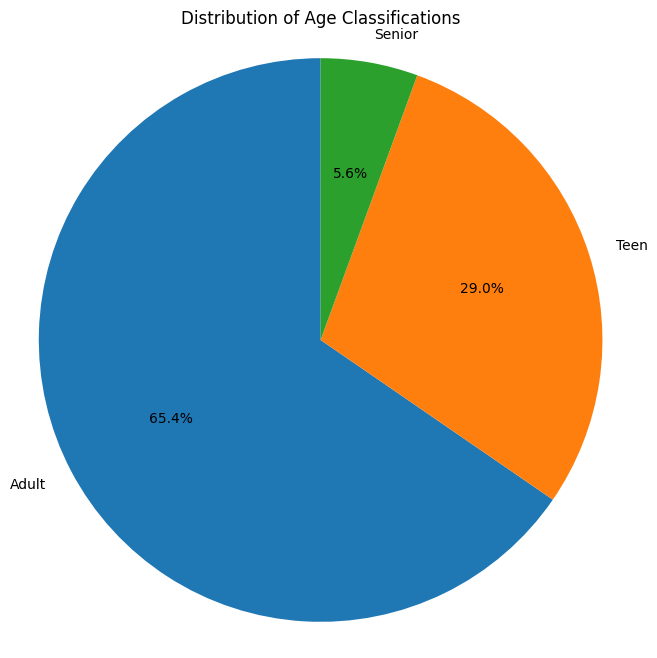

In [ ]:
# Renaming columns for the pie chart
classified_victim_age.columns = ['Age Classification', 'Count']

# Plotting the pie chart
plt.figure(figsize=(8,8))
plt.pie(classified_victim_age['Count'], labels=classified_victim_age['Age Classification'], autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Age Classifications')
plt.axis('equal')

# Equal aspect ratio ensures that pie is drawn as a circle.
# Display the pie chart
plt.show()

    month_occ  Crime_count
0           1     18510.60
1           2     17260.00
2           3     17541.00
3           4     16685.40
4           5     16586.40
5           6     16253.40
6           7     16763.00
7           8     16704.60
8           9     15924.20
9          10     19065.50
10         11     17938.50
11         12     18369.75


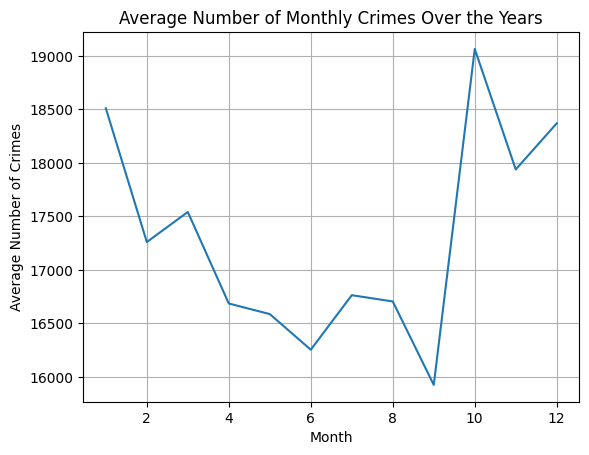

In [ ]:
# Count crimes by season
monthly_crime_count = df.groupby(['year_occ', 'month_occ']).size().reset_index(name='Crime_count')
monthly_avg_crime = monthly_crime_count.groupby('month_occ')['Crime_count'].mean().reset_index()
print(monthly_avg_crime)
# Plot average monthly crimes
plt.plot(monthly_avg_crime['month_occ'], monthly_avg_crime['Crime_count'])
plt.xlabel('Month')
plt.ylabel('Average Number of Crimes')
plt.title('Average Number of Monthly Crimes Over the Years')
plt.grid()
plt.show()

In [ ]:
#Count the occurrences of each crime type
crime_type_count = df['Crm Cd Desc'].value_counts()
pd.set_option('display.max_rows', None)
print(crime_type_count)

#dentify the one with the highest frequency
print("\nThe most common type of crime is:",df['Crm Cd Desc'].value_counts().idxmax())

Crm Cd Desc
VEHICLE - STOLEN                                            110804
BATTERY - SIMPLE ASSAULT                                     74688
BURGLARY FROM VEHICLE                                        61324
THEFT OF IDENTITY                                            60867
VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)      59639
BURGLARY                                                     57743
ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT               53395
THEFT PLAIN - PETTY ($950 & UNDER)                           51384
INTIMATE PARTNER - SIMPLE ASSAULT                            46696
THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER)              39550
THEFT FROM MOTOR VEHICLE - GRAND ($950.01 AND OVER)          35677
THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LIVESTK,PROD     33707
ROBBERY                                                      32190
SHOPLIFTING - PETTY THEFT ($950 & UNDER)                     28830
VANDALISM - MISDEAMEANOR ($399 OR UNDER)          

   year_occ  ve_stolen_count
0      2020            20771
1      2021            23683
2      2022            24742
3      2023            24464
4      2024            17144


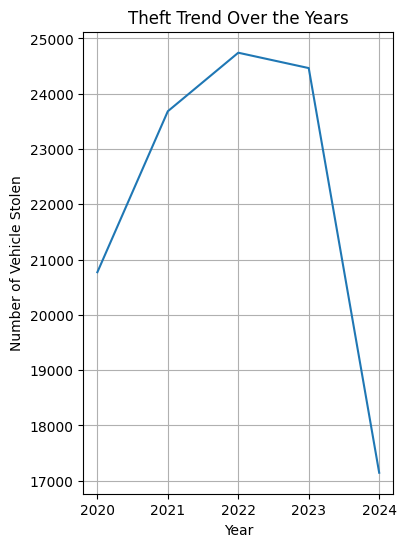

In [ ]:
#plot vehicle stolen (Highest Number of Crime type)
ve_stolen_count = df['Crm Cd Desc'].value_counts()['VEHICLE - STOLEN']
ve_stolen = df[df['Crm Cd Desc'] == 'VEHICLE - STOLEN']
trend = ve_stolen.groupby('year_occ').size().reset_index(name='ve_stolen_count')
print(trend)
plt.figure(figsize=(4, 6))
plt.plot(trend['year_occ'], trend['ve_stolen_count'])
plt.title('Theft Trend Over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Vehicle Stolen')
plt.grid()
plt.show()

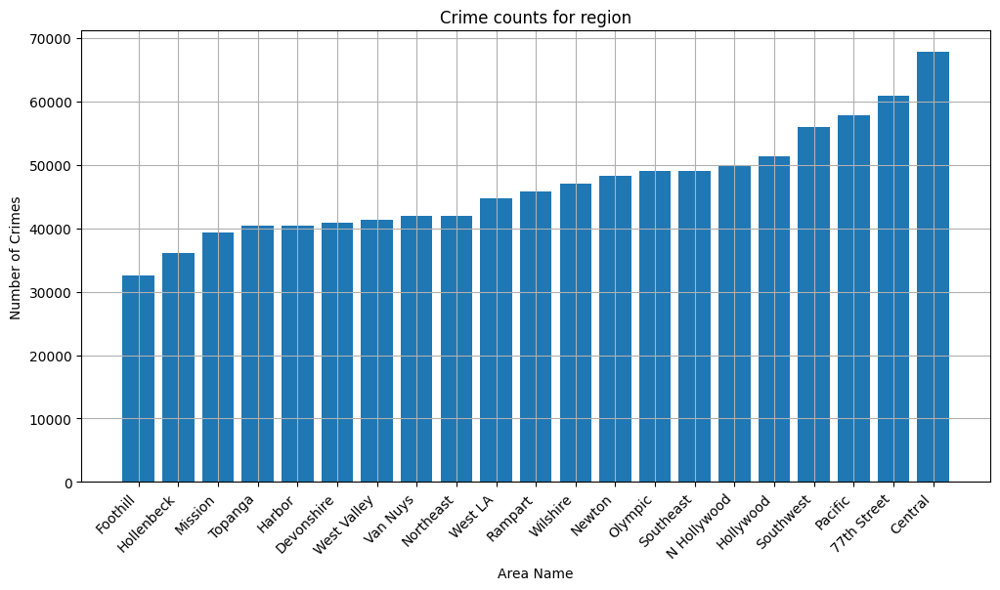

In [ ]:
#Regional Differences
df['AREA NAME'].value_counts().reset_index(name='crime_count')
plt.figure(figsize=(12, 6))
area_crime = df.groupby("AREA NAME").size().reset_index(name='crime_count')
area_crime = area_crime.sort_values(by = 'crime_count')
plt.bar(area_crime['AREA NAME'], area_crime['crime_count'])
plt.title('Crime counts for region')
plt.xlabel('Area Name')
plt.ylabel('Number of Crimes')
plt.xticks(rotation=45, ha='right')
plt.grid()
plt.show()

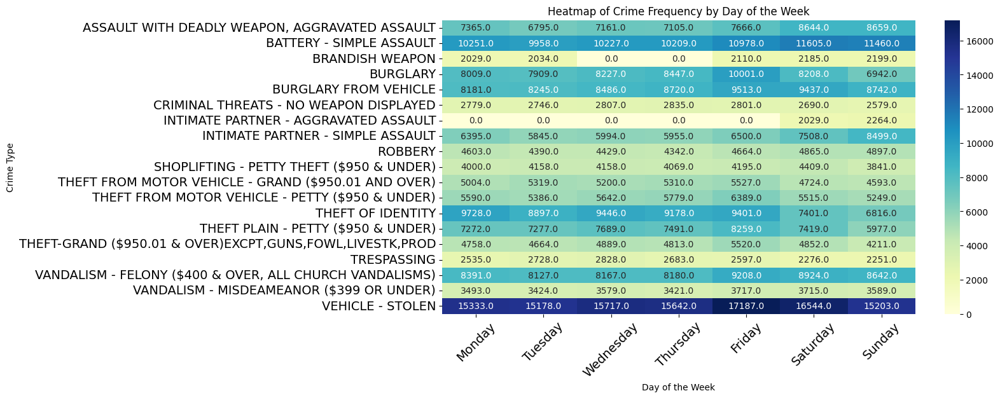

In [ ]:
#Day of the Week Analysis
crime_day_freq = df.groupby(['day_name', 'Crm Cd Desc']).size().reset_index(name='Frequency')
crime_day_filtered = crime_day_freq[crime_day_freq['Frequency'] > 2000]
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
pivot_table = crime_day_filtered.pivot_table(values='Frequency', index='Crm Cd Desc', columns='day_name', fill_value=0)
pivot_table = pivot_table[ordered_days]

#we can use std also to show the relation b/w crimes and day of week
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, annot=True, fmt=".1f", cmap='YlGnBu')
plt.title('Heatmap of Crime Frequency by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Crime Type')
plt.xticks(fontsize=14, rotation=45)
plt.yticks(fontsize=14)
plt.show()

## Dealing with Outliers and Anomalies

In [ ]:
df['TIME OCC'].head(3)

,TIME OCC
0,2130
1,1800
2,1700


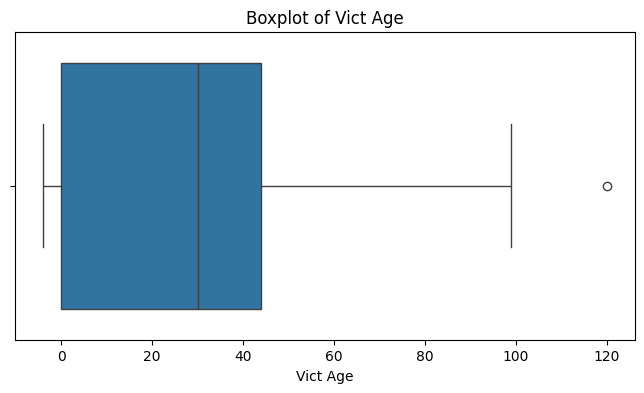

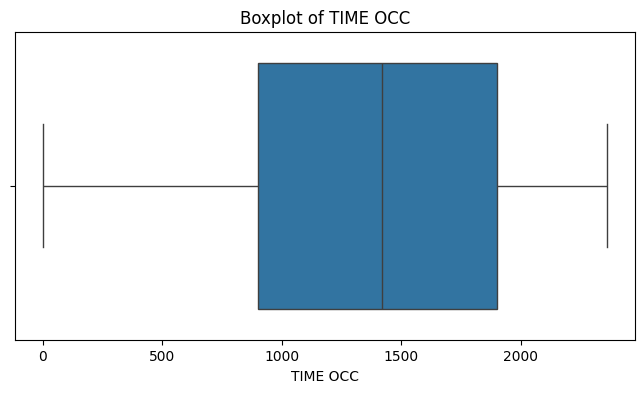

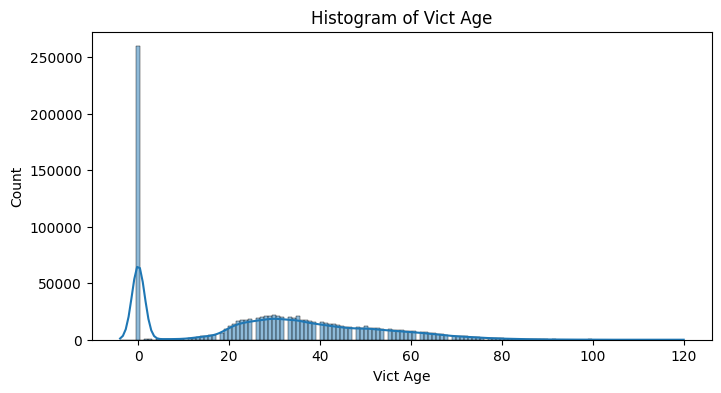

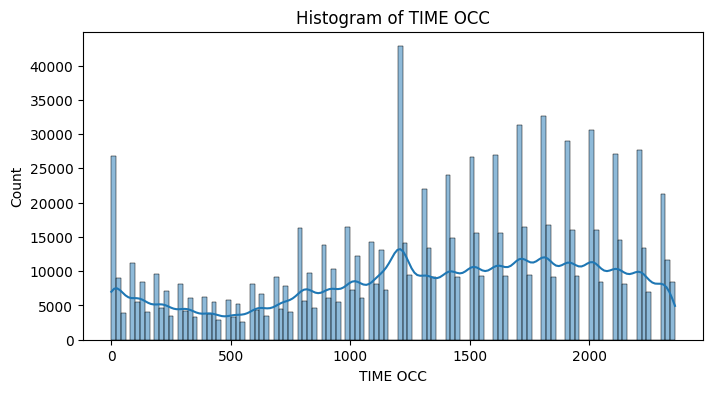

Number of outliers in Vict Age: 1
Number of outliers in TIME OCC: 0
              DR_NO                      Date Rptd  \
count  9.826380e+05                         982638   
mean   2.197437e+08  2022-05-05 10:42:13.208771328   
min    8.170000e+02            2020-01-01 00:00:00   
25%    2.106089e+08            2021-04-10 00:00:00   
50%    2.208146e+08            2022-05-22 00:00:00   
75%    2.309153e+08            2023-06-07 00:00:00   
max    2.499253e+08            2024-09-30 00:00:00   
std    1.294954e+07                            NaN   

                            DATE OCC       TIME OCC           AREA  \
count                         982638  982638.000000  982638.000000   
mean   2022-04-23 14:04:36.221355264    1338.781867      10.700277   
min              2020-01-01 00:00:00       1.000000       1.000000   
25%              2021-03-27 00:00:00     900.000000       5.000000   
50%              2022-05-08 00:00:00    1420.000000      11.000000   
75%              2023-05-

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Update the numeric columns to exclude LAT and LON
numeric_cols = ['Vict Age', 'TIME OCC']  # Add other numeric columns if needed, but exclude LAT and LON

# Boxplot to visualize outliers
for col in numeric_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot of {col}')
    plt.show()

# Histogram to visualize data distribution
for col in numeric_cols:
    plt.figure(figsize=(8, 4))
    sns.histplot(df[col], kde=True)
    plt.title(f'Histogram of {col}')
    plt.show()


# Function to detect outliers using the IQR method
def detect_outliers(df, col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[col] < lower_bound) | (df[col] > upper_bound)]

# Applying outlier detection
outliers = {}
for col in numeric_cols:
    outliers[col] = detect_outliers(df, col)
    print(f"Number of outliers in {col}: {len(outliers[col])}")

# Handling Outliers - Capping the outliers at 1st and 99th percentiles
for col in numeric_cols:
    lower_limit = df[col].quantile(0.01)
    upper_limit = df[col].quantile(0.99)
    df[col] = np.where(df[col] < lower_limit, lower_limit, df[col])
    df[col] = np.where(df[col] > upper_limit, upper_limit, df[col])

# Checking the data after handling outliers
print(df.describe())



(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5]),
 [Text(0.5, 0, 'ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT'),
  Text(1.5, 0, 'BATTERY - SIMPLE ASSAULT'),
  Text(2.5, 0, 'BURGLARY'),
  Text(3.5, 0, 'BURGLARY FROM VEHICLE'),
  Text(4.5, 0, 'INTIMATE PARTNER - SIMPLE ASSAULT'),
  Text(5.5, 0, 'THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER)'),
  Text(6.5, 0, 'THEFT OF IDENTITY'),
  Text(7.5, 0, 'THEFT PLAIN - PETTY ($950 & UNDER)'),
  Text(8.5, 0, 'VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)'),
  Text(9.5, 0, 'VEHICLE - STOLEN')])

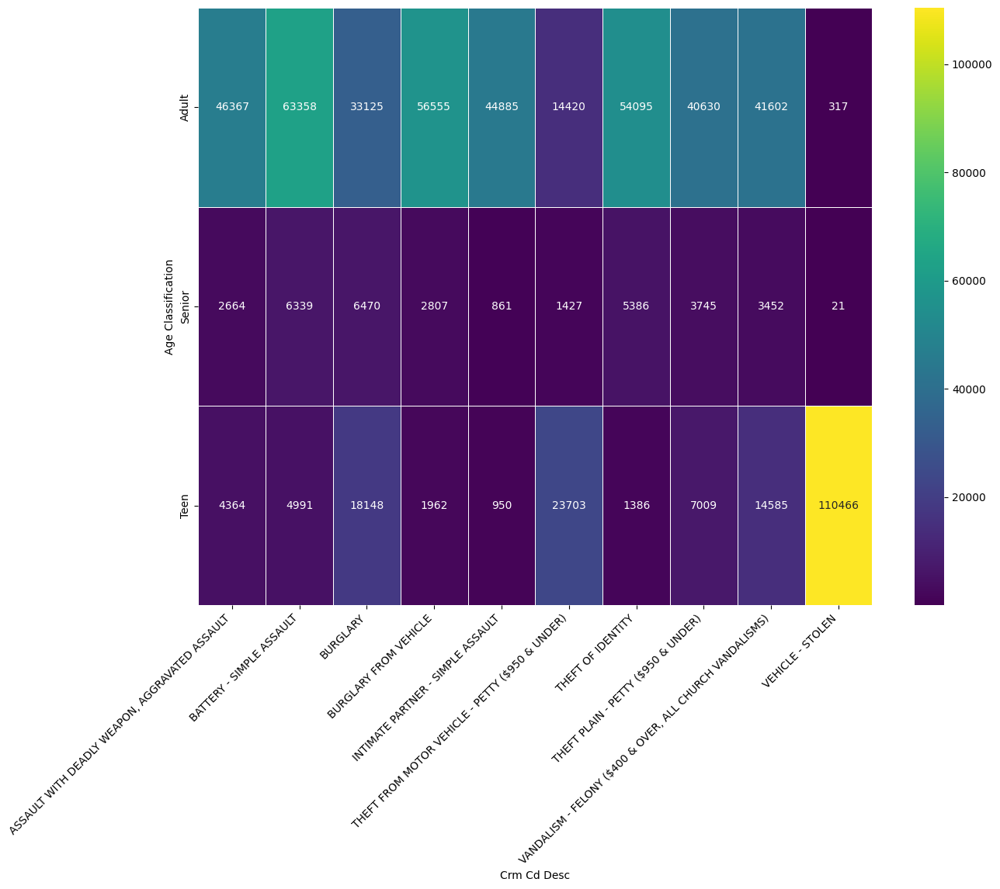

In [ ]:
# First, get the most frequent crime types
top_crimes = df['Crm Cd Desc'].value_counts().head(10).index

# Top 10 crime␣ ↪types
# Filter the dataset to include only the top crime types
filtered_data = df[df['Crm Cd Desc'].isin(top_crimes)]

# Create a cross-tabulation with filtered data
age_crime_correlation = pd.crosstab(filtered_data['Age Classification'],
                                                   filtered_data['Crm Cd Desc'])
# Visualize again with the improved heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(age_crime_correlation, cmap='viridis', annot=True, fmt='d', linewidths=0.5)

# Rotate the x-axis labels and add a title
plt.xticks(rotation=45, ha='right')

In [ ]:
!pip install folium

In [ ]:
# Create the geoplot for LAT and LON
import folium
from folium.plugins import HeatMap

# Create a base map centered around the mean location
center_location = [df['LAT'].mean(), df['LON'].mean()]
m = folium.Map(location=center_location, zoom_start=12)

# Filter the dataframe to remove any null values in LAT and LON
df_clean = df.dropna(subset=['LAT', 'LON'])

# Create a list of latitude and longitude points for the heatmap
heat_data = [[row['LAT'], row['LON']] for index, row in df_clean.iterrows()]

# Add a heatmap layer to the map
HeatMap(heat_data).add_to(m)

# Save the map to an HTML file or display it inline (depending on the environment)
m.save("crime_hotspots.html")

# For Jupyter notebooks, you can display the map inline:
m

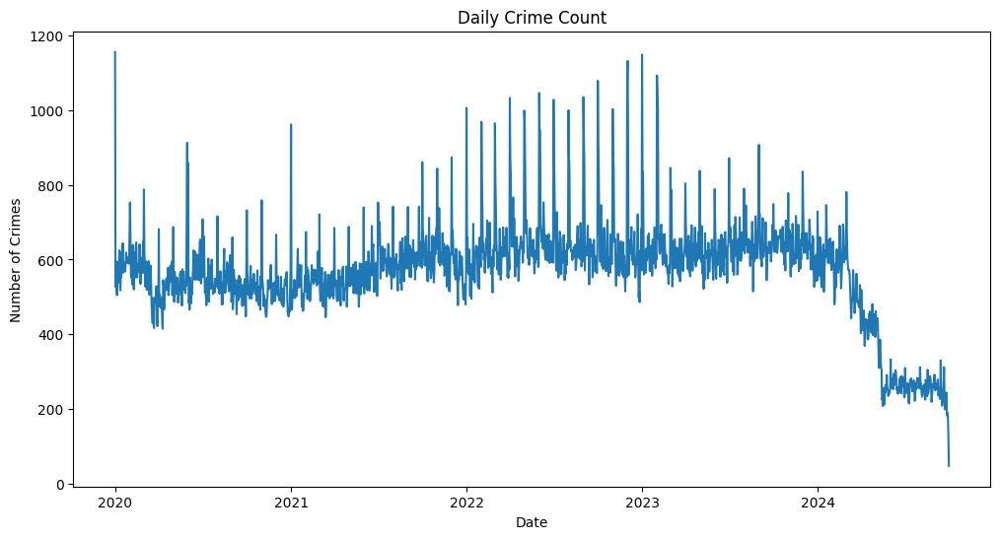

In [ ]:
# Ensure date column is in datetime format
df['DATE OCC'] = pd.to_datetime(df['DATE OCC'])

# Aggregate the data by date to count the number of crimes per day
crime_daily = df.groupby('DATE OCC').size().reset_index(name='crime_count')

# Set the date column as index
crime_daily.set_index('DATE OCC', inplace=True)

# Visualize the crime trends over time
plt.figure(figsize=(12,6))
plt.plot(crime_daily)
plt.title('Daily Crime Count')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.show()


# Initial Model Fit on SARIMAX

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


SARIMAX RMSE: 294.9019598764616
                                     SARIMAX Results                                      
Dep. Variable:                        crime_count   No. Observations:                 1370
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood               -7793.866
Date:                            Wed, 16 Oct 2024   AIC                          15597.733
Time:                                    01:12:10   BIC                          15623.798
Sample:                                01-01-2020   HQIC                         15607.492
                                     - 10-01-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4589      0.018     26.074      0.000       0.424       0.493
ma.

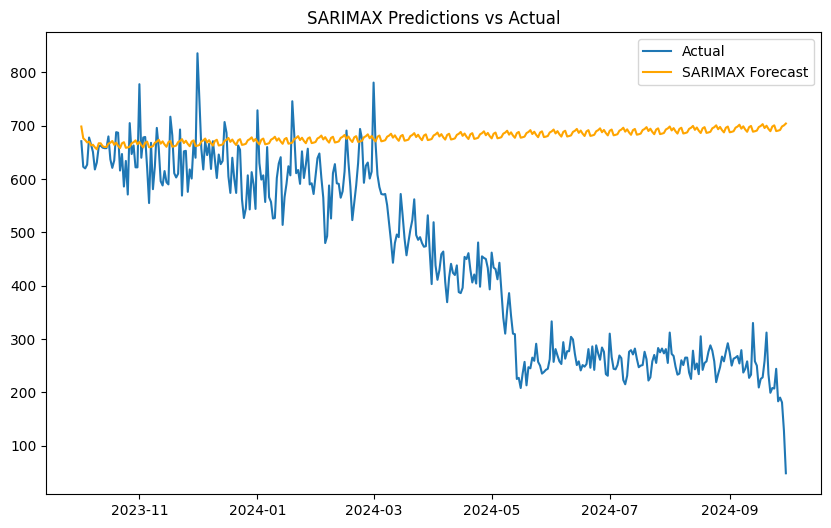

In [ ]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error

# Train-test split
train = crime_daily.iloc[:-365]  # Train on all but the last year
test = crime_daily.iloc[-365:]   # Test on the last year

# Fit SARIMAX model (p,d,q)(P,D,Q,S) can be tuned
model_sarimax = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, 12))
sarimax_fit = model_sarimax.fit()

# Predict future values
sarimax_predictions = sarimax_fit.forecast(steps=365)

# Evaluate the SARIMAX model
sarimax_rmse = np.sqrt(mean_squared_error(test, sarimax_predictions))
print(f'SARIMAX RMSE: {sarimax_rmse}')


print(sarimax_fit.summary())

# Plot SARIMAX predictions
plt.figure(figsize=(10,6))
plt.plot(test, label='Actual')
plt.plot(test.index, sarimax_predictions, label='SARIMAX Forecast', color='orange')
plt.title('SARIMAX Predictions vs Actual')
plt.legend()
plt.show()


### Grid Search Sarimax

In [ ]:
import itertools
import statsmodels.api as sm

# Define the parameter ranges
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))

# Seasonal parameter ranges (P, D, Q, and S)
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in pdq]  # Assuming monthly seasonality

# Grid search to find the best combination of parameters
best_aic = float('inf')
best_params = None

for param in pdq:
    for seasonal_param in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(train,
                                            order=param,
                                            seasonal_order=seasonal_param,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)
            results = mod.fit()

            if results.aic < best_aic:
                best_aic = results.aic
                best_params = (param, seasonal_param)
        except:
            continue

print(f'Best SARIMAX parameters: {best_params}')


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dat

Best SARIMAX parameters: ((1, 1, 1), (0, 1, 1, 12))


In [ ]:
df.columns

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Crm Cd Desc', 'Mocodes',
       'Vict Age', 'Vict Sex', 'Vict Descent', 'Premis Cd', 'Premis Desc',
       'Status', 'Status Desc', 'Crm Cd 1', 'LOCATION', 'LAT', 'LON',
       'day_occ', 'month_occ', 'year_occ', 'day', 'day_name',
       'Age Classification'],
      dtype='object')

In [ ]:
train.index

DatetimeIndex(['2020-01-01', '2020-01-02', '2020-01-03', '2020-01-04',
               '2020-01-05', '2020-01-06', '2020-01-07', '2020-01-08',
               '2020-01-09', '2020-01-10',
               ...
               '2023-09-22', '2023-09-23', '2023-09-24', '2023-09-25',
               '2023-09-26', '2023-09-27', '2023-09-28', '2023-09-29',
               '2023-09-30', '2023-10-01'],
              dtype='datetime64[ns]', name='DATE OCC', length=1370, freq=None)

# Running SARIMAX on the best hyper-parameters from Grid Search

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                                     SARIMAX Results                                      
Dep. Variable:                        crime_count   No. Observations:                 1370
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 12)   Log Likelihood               -7776.824
Date:                            Wed, 16 Oct 2024   AIC                          15561.647
Time:                                    01:13:46   BIC                          15582.499
Sample:                                01-01-2020   HQIC                         15569.454
                                     - 10-01-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4012      0.017     23.272      0.000       0.367       0.435
ma.L1         -0.9783      0.007   

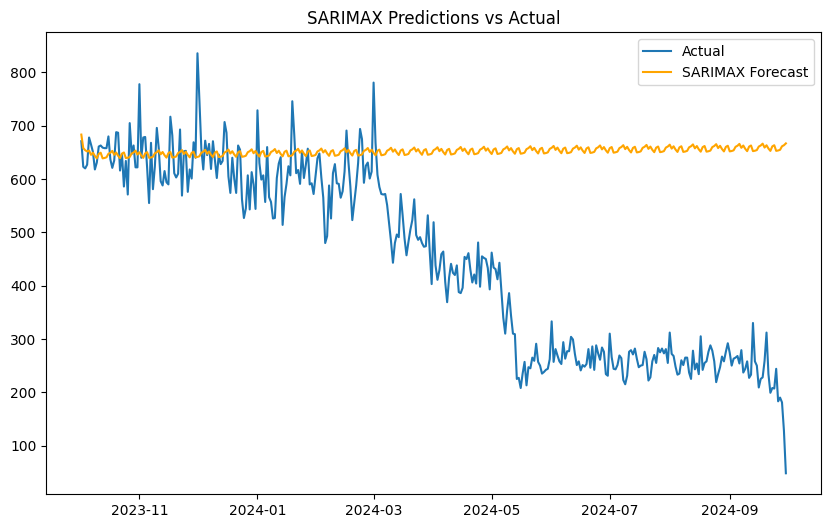

In [ ]:
# Import necessary libraries
import statsmodels.api as sm

# Fit the SARIMAX model with best parameters
best_order = (1, 1, 1)  # From grid search
best_seasonal_order = (0, 1, 1, 12)  # From grid search

model = SARIMAX(train, order=best_order, seasonal_order=best_seasonal_order)
sarimax_grid_search_result = model.fit()

# Display model summary
print(sarimax_grid_search_result.summary())

# Predict future values
sarimax_predictions = sarimax_grid_search_result.forecast(steps=365)

# Evaluate the SARIMAX model
sarimax_rmse = np.sqrt(mean_squared_error(test, sarimax_predictions))
print(f'SARIMAX RMSE: {sarimax_rmse}')

# Plot SARIMAX predictions
plt.figure(figsize=(10,6))
plt.plot(test, label='Actual')
plt.plot(test.index, sarimax_predictions, label='SARIMAX Forecast', color='orange')
plt.title('SARIMAX Predictions vs Actual')
plt.legend()
plt.show()


In [ ]:
# Calculate skewness for crime_count column
skewness_crime_count = crime_daily['crime_count'].skew()
print(f'Skewness of crime count: {skewness_crime_count}')


Skewness of crime count: -0.3232638885876734


### Log of Data Transformation

> Add blockquote



/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                                     SARIMAX Results                                      
Dep. Variable:                    log_crime_count   No. Observations:                 1735
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 12)   Log Likelihood                1330.959
Date:                            Wed, 16 Oct 2024   AIC                          -2653.918
Time:                                    01:13:53   BIC                          -2632.113
Sample:                                01-01-2020   HQIC                         -2645.851
                                     - 09-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4027      0.025     16.251      0.000       0.354       0.451
ma.L1         -0.9046      0.014   

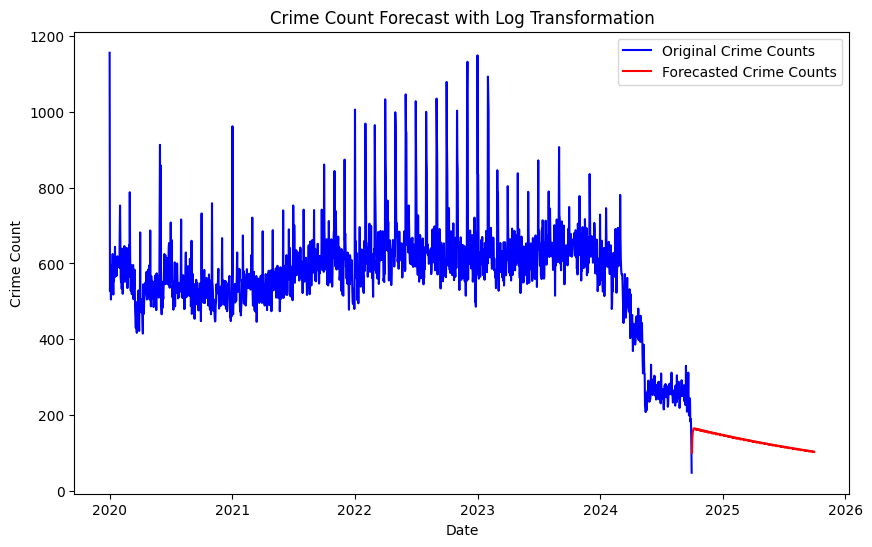

In [ ]:
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error

# Apply log transformation to crime_count (add 1 to avoid log(0))
crime_daily['log_crime_count'] = np.log(crime_daily['crime_count'] + 1)

# Fit SARIMAX model on log-transformed data
model_log = SARIMAX(crime_daily['log_crime_count'], order=best_order, seasonal_order=best_seasonal_order)
sarimax_result_log = model_log.fit()

# Display model summary
print(sarimax_result_log.summary())

# Forecast future values (log-transformed)
forecast_log = sarimax_result_log.get_forecast(steps=len(test))
forecast_log_values = forecast_log.predicted_mean

# Convert log-transformed forecasts back to original scale
forecast_original_scale = np.exp(forecast_log_values) - 1

# Evaluate the SARIMAX model on the original scale
# Ensure 'test' contains actual crime counts (non-log scale)
sarimax_rmse = np.sqrt(mean_squared_error(test, forecast_original_scale))
print(f'SARIMAX RMSE (on original scale): {sarimax_rmse}')

# Plot the original vs forecasted values
plt.figure(figsize=(10, 6))
plt.plot(crime_daily.index, crime_daily['crime_count'], label='Original Crime Counts', color='blue')
plt.plot(forecast_original_scale.index, forecast_original_scale, label='Forecasted Crime Counts', color='red')
plt.title('Crime Count Forecast with Log Transformation')
plt.xlabel('Date')
plt.ylabel('Crime Count')
plt.legend()
plt.show()


In [ ]:
# #forecast_original_scale.index
# print(train['crime_count'].nunique())
# print(test.index)

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                                     SARIMAX Results                                      
Dep. Variable:                   sqrt_crime_count   No. Observations:                 1735
Model:             SARIMAX(1, 1, 1)x(0, 1, 1, 12)   Log Likelihood               -2965.590
Date:                            Wed, 16 Oct 2024   AIC                           5939.180
Time:                                    01:14:08   BIC                           5960.985
Sample:                                01-01-2020   HQIC                          5947.247
                                     - 09-30-2024                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3957      0.020     19.912      0.000       0.357       0.435
ma.L1         -0.9302      0.011   

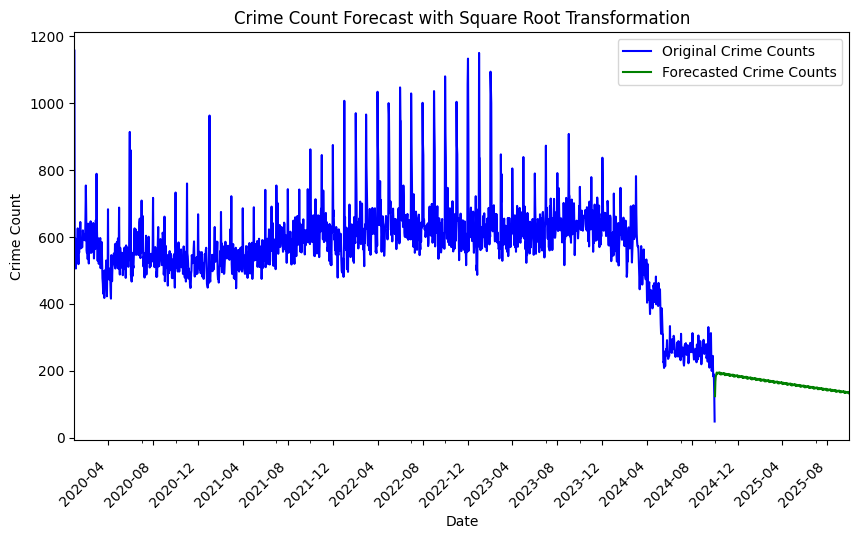

In [ ]:

import matplotlib.dates as mdates

# Apply square root transformation to crime_count
crime_daily['sqrt_crime_count'] = np.sqrt(crime_daily['crime_count'])

# Fit SARIMAX model on square root-transformed data
model_sqrt = SARIMAX(crime_daily['sqrt_crime_count'], order=best_order, seasonal_order=best_seasonal_order)
sarimax_result_sqrt = model_sqrt.fit()

# Display model summary
print(sarimax_result_sqrt.summary())

# Forecast future values
forecast_sqrt = sarimax_result_sqrt.get_forecast(steps=365)
forecast_sqrt_values = forecast_sqrt.predicted_mean

# Convert square root-transformed forecasts back to original scale
forecast_original_scale_sqrt = np.square(forecast_sqrt_values)

# Evaluation: Calculate RMSE on the transformed data
sarimax_rmse_sqrt = np.sqrt(mean_squared_error(crime_daily['crime_count'][-365:], forecast_original_scale_sqrt))
print(f'SARIMAX RMSE (Square Root Transformation): {sarimax_rmse_sqrt}')

# Assuming 'crime_daily' has a DateTime index or a 'date' column
plt.figure(figsize=(10, 6))

# Plot the original crime counts
crime_daily['crime_count'].plot(label='Original Crime Counts', color='blue')

# Plot the forecasted counts
forecast_original_scale_sqrt.plot(label='Forecasted Crime Counts', color='green')

# Set the x-axis to show ticks at 4-month intervals for clarity
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=4))  # Set interval to every 4 months

# Format the date labels as 'Year-Month'
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

# Rotate the tick labels for better readability
plt.gcf().autofmt_xdate(rotation=45, ha='right')  # Rotate 45 degrees and align right

# Add padding between the x-axis labels and the plot for better readability
plt.gca().tick_params(axis='x', pad=10)

# Plot title and labels
plt.title('Crime Count Forecast with Square Root Transformation')
plt.xlabel('Date')  # X-axis label
plt.ylabel('Crime Count')  # Y-axis label

# Add the legend
plt.legend()

# Show the plot
plt.show()

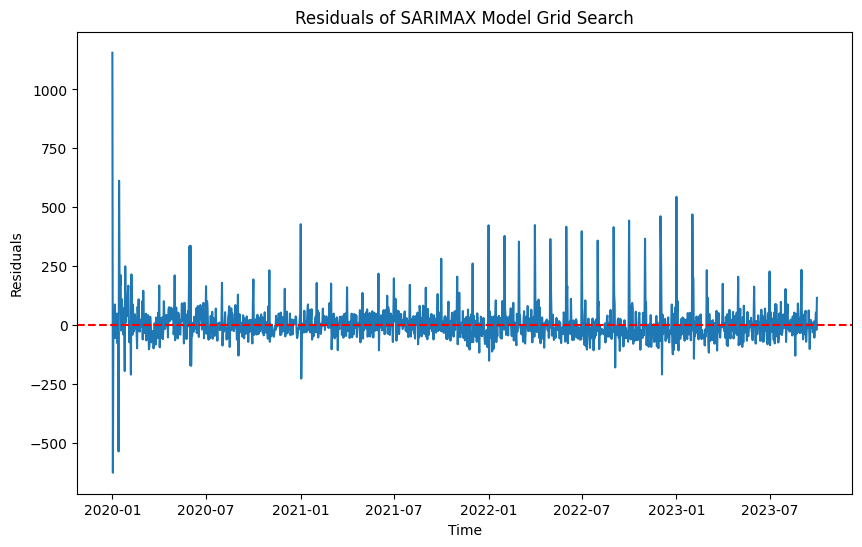

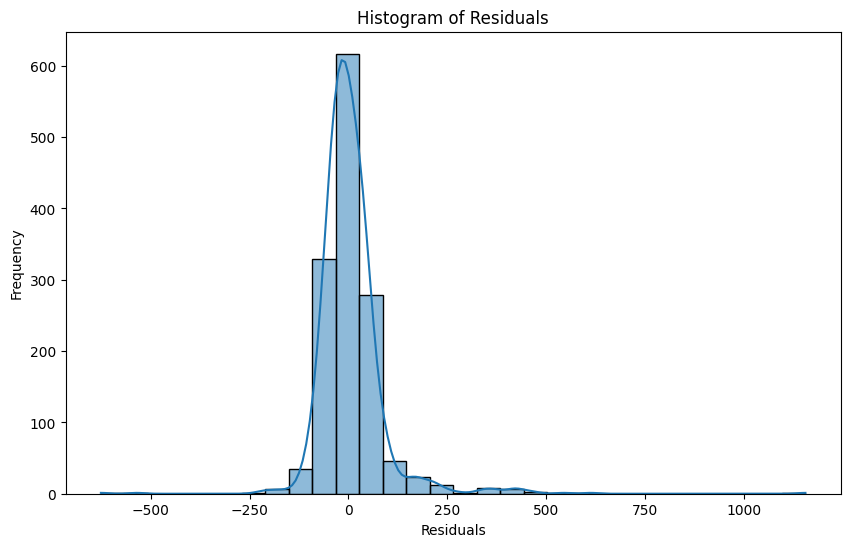

In [ ]:
# Get the residuals for DailyCrime counts forecasts
residuals = sarimax_grid_search_result.resid

# Plotting residuals
plt.figure(figsize=(10, 6))
plt.plot(residuals)
plt.axhline(y=0, color='r', linestyle='--')
plt.title('Residuals of SARIMAX Model Grid Search')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.show()

# Histogram of residuals
plt.figure(figsize=(10, 6))
sns.histplot(residuals, bins=30, kde=True)
plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.show()



### This histogram of residuals from the SARIMAX forecast output provides insights into how well the model is performing. Here's what it means:

### Residuals Centered Around Zero: The majority of the residuals (errors between predicted and actual values) are concentrated near zero. This indicates that, on average, the SARIMAX model is making predictions that are fairly accurate.

### Skewness: There seems to be a slight skew to the right in the residuals (more residuals with larger positive values than negative values). This suggests that the model may be underpredicting some values, leading to positive errors.

### Spread: The spread of the residuals (ranging approximately from -500 to 1000) shows the variability of the errors. A wider spread suggests greater deviations between actual and predicted values, though most residuals are still close to zero.

### Normality: Ideally, the residuals should follow a normal distribution (a bell-shaped curve centered around zero) if the model is well-fitted. Your residuals are mostly centered around zero, but it is slightly right-skewed, which may suggest some issues like non-stationarity or unmodeled trends.

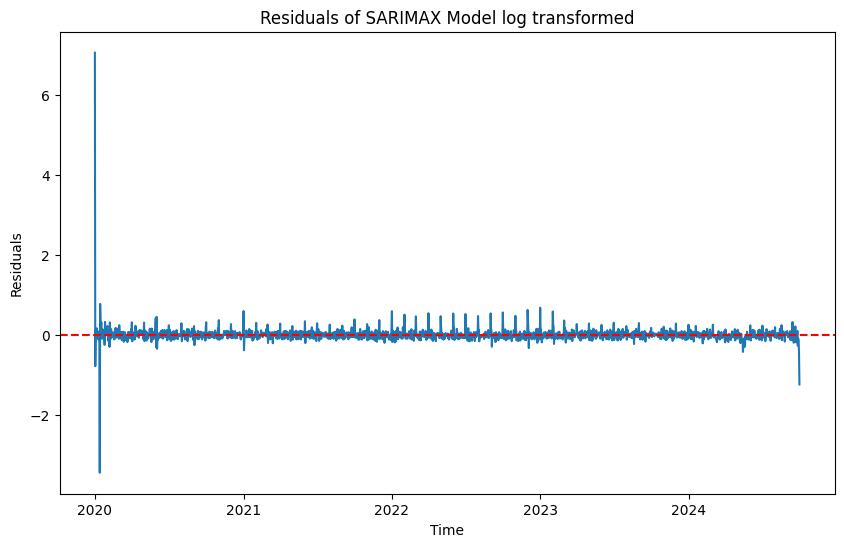

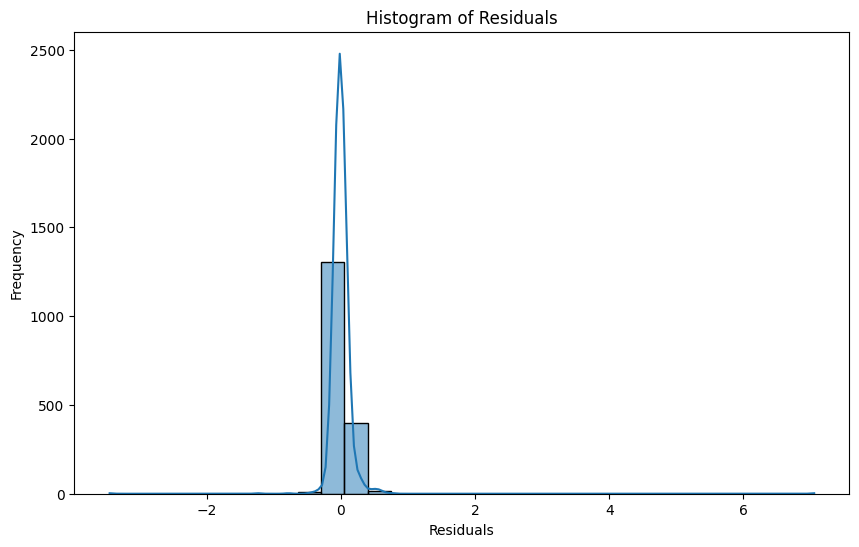

In [ ]:
# Get the residuals
residuals_log_transformed = sarimax_result_log.resid

# Plotting residuals
plt.figure(figsize=(10, 6))
plt.plot(residuals_log_transformed)
plt.axhline(y=0, color='r', linestyle='--')
plt.title('Residuals of SARIMAX Model log transformed')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.show()

# Histogram of residuals
plt.figure(figsize=(10, 6))
sns.histplot(residuals_log_transformed, bins=30, kde=True)
plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.show()


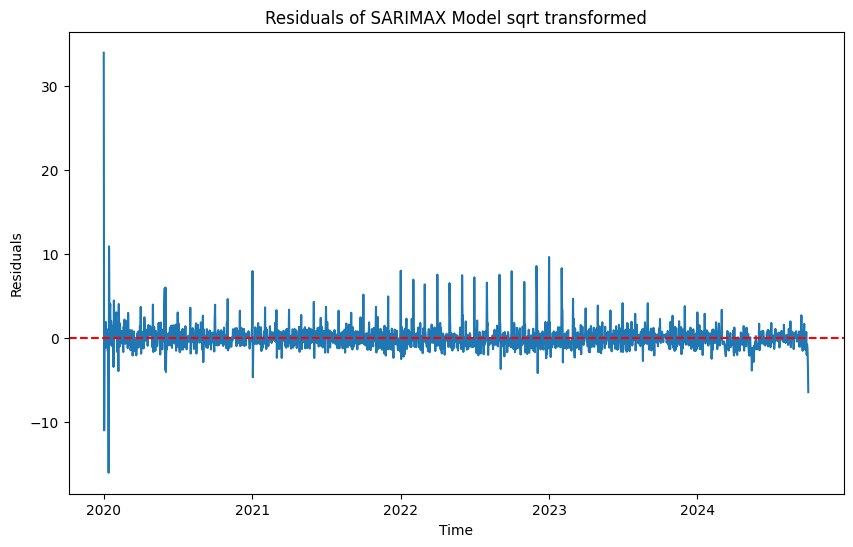

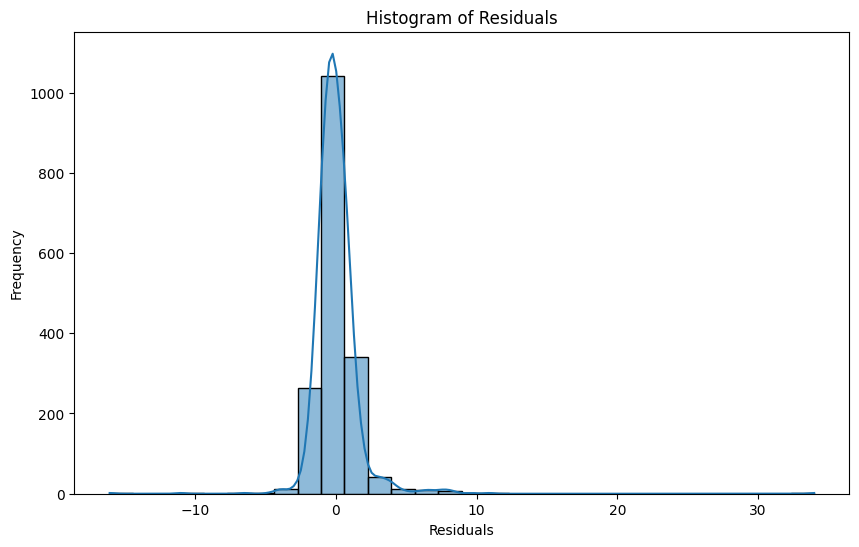

In [ ]:
# Get the residuals
residuals_sqrt_transformed = sarimax_result_sqrt.resid

# Plotting residuals
plt.figure(figsize=(10, 6))
plt.plot(residuals_sqrt_transformed)
plt.axhline(y=0, color='r', linestyle='--')
plt.title('Residuals of SARIMAX Model sqrt transformed')
plt.xlabel('Time')
plt.ylabel('Residuals')
plt.show()

# Histogram of residuals
plt.figure(figsize=(10, 6))
sns.histplot(residuals_sqrt_transformed, bins=30, kde=True)
plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.show()


### Key Observations: Narrower Spread: The range of residuals is much tighter, primarily between -10 and 30. This suggests that the square root transformation has reduced the variance in the data, leading to smaller prediction errors, which is typical when working with frequency data or data with non-negative values.

### Symmetry: The residuals appear more symmetrically distributed around zero, with a sharp peak at zero. This is a sign of a well-fitted model, as the errors (difference between the actual and predicted values) are mostly centered around zero and evenly distributed.

### Reduction in Skewness: Unlike the previous histogram, there is minimal skewness here. The residuals are more concentrated around the center (zero), indicating that the model is less biased towards over- or under-predicting the values after applying the square root transformation.

### Transformation Impact: By applying a square root transformation, you likely stabilized the variance, making the residuals behave more like a normal distribution. This can be particularly useful when dealing with count data, which often has heteroscedasticity (non-constant variance).

### In Summary: The square root transformation appears to have had a positive effect by reducing the spread of residuals and making them more symmetrical around zero. This suggests that your SARIMAX model is performing better with the transformed data, yielding more consistent and accurate predictions. However, further diagnostics (like checking autocorrelation in the residuals or conducting a Ljung-Box test) can help ensure that all potential issues have been addressed.